In [1]:
from influxdb import InfluxDBClient
import pandas as pd
import dataclasses
import numpy as np
from scipy import signal

import matplotlib.pyplot as plt
import plotly.express as px

import os
import pickle
from pathlib import Path
import pandas as pd
import numpy as np
from scipy import signal
from scipy.stats import zscore
import sys

RICA_HOME = '/home/shankar/All_thesis/Thesis_program'
sys.path.append(RICA_HOME)

%matplotlib widget
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import seaborn as sns

from sklearn.manifold import TSNE
from sklearn.metrics import silhouette_samples

from rica.domain.vibration import vibration
from rica.domain.configure import configure
from rica.use_cases.filter import create_filter_bank, filter_signal
from rica.use_cases.power import (compute_min_max_power, compute_power,
                                  create_power_object)
from rica.domain.density import ExtendedKMeans
from rica.use_cases.density import create_densityModule_object, model_predict, load_ExtendedKMeans

In [2]:
data=pd.read_csv("/home/shankar/All_thesis/Thesis_program/Data/shawnee/011623-shanee-post-processed.csv")
data

,Unnamed: 0,level_0,Unnamed: 0.1,density,heading,latitude,longitude,passID,speed,temperature,time,density_post
0,0,2,NaN,86.00,90.0,35.665579,-96.662354,0,0.035,97.996996,2023-01-16 15:14:33.712000+00:00,91.03
1,1,3,NaN,86.00,90.0,35.665579,-96.662354,0,0.035,97.778299,2023-01-16 15:14:33.840000+00:00,91.03
2,2,4,NaN,86.00,90.0,35.665579,-96.662354,0,0.035,97.583898,2023-01-16 15:14:33.968000+00:00,91.03
3,3,5,NaN,86.00,90.0,35.665579,-96.662354,0,0.035,97.754003,2023-01-16 15:14:34.096000+00:00,91.03
4,4,6,NaN,86.00,90.0,35.665579,-96.662354,0,0.035,97.875500,2023-01-16 15:14:34.224000+00:00,91.03
...,...,...,...,...,...,...,...,...,...,...,...,...
166476,6081,6083,NaN,91.03,-0.0,35.680961,-96.662498,324,0.046,114.326599,2023-01-16 21:13:00.058000+00:00,91.03
166477,6082,6084,NaN,91.03,-0.0,35.680961,-96.662498,324,0.046,113.816306,2023-01-16 21:13:00.186000+00:00,91.03
166478,6083,6085,NaN,91.03,-0.0,35.680961,-96.662498,324,0.046,114.132202,2023-01-16 21:13:00.314000+00:00,91.03
166479,6084,6086,NaN,91.03,-0.0,35.680961,-96.662498,324,0.046,113.986403,2023-01-16 21:13:00.442000+00:00,91.03


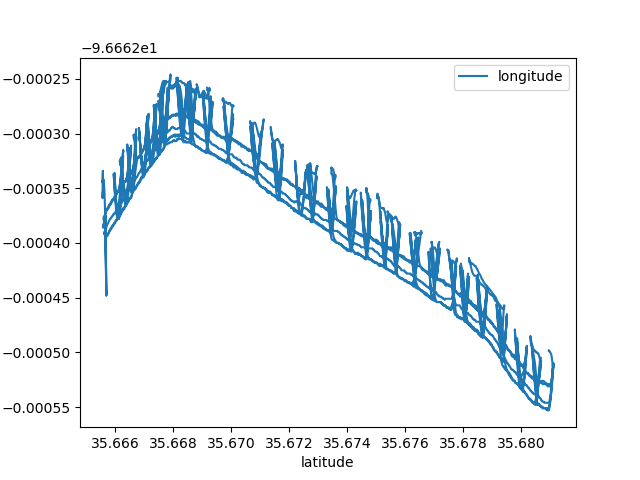

In [3]:
data[data["latitude"]>0.1][["latitude","longitude"]].plot(x="latitude",y="longitude")

In [8]:
px.scatter(
    data[(data["latitude"]!=0.000000)&
                   (data["density_post"]>=90.1)
                  ][["latitude","longitude","passID","density_post","time","heading"]],
    x="latitude",
    y="longitude",
    hover_name="passID", 
    hover_data=["time", "density_post"],
    color="density_post",
    width=800,
    height=800
)

In [10]:
px.scatter(
    data[(data["latitude"]!=0.000000)&
         (data["latitude"]>=35.6700)&
         (data["latitude"]<=35.6708)&
         (data["longitude"]>=-96.66235)&
         (data["longitude"]<=-96.66230)&
         (data["passID"]>=114)&
         (data["passID"]<125)&
         (data["density_post"]>=90.1)
                  ][["latitude","longitude","passID","density_post","time"]],
    x="latitude",
    y="longitude",
    hover_name="passID", 
    hover_data=["time", "density_post"],
    color="density_post",
    width=1000,
    height=800
)

In [16]:

data_to_look=data[(data["latitude"]!=0.000000)&
         (data["latitude"]>=35.6700)&
         (data["latitude"]<=35.6708)&
         (data["longitude"]>=-96.66235)&
         (data["longitude"]<=-96.66230)&
         (data["passID"]>=114)&
         (data["passID"]<125)&
         (data["density_post"]>=90.1)
                  ]
# def get_start_stop(data_to_look):
passIDs=data_to_look.passID.unique()
[[data_to_look[data["passID"]==x].time.min(),data_to_look[data["passID"]==x].time.max(),x] for x in passIDs]

/home/shankar/anaconda3/envs/Thesis/lib/python3.7/site-packages/ipykernel_launcher.py:12: UserWarning:

Boolean Series key will be reindexed to match DataFrame index.



[['2023-01-16 17:24:39.706000+00:00', '2023-01-16 17:25:24.506000+00:00', 115],
 ['2023-01-16 17:25:52.666000+00:00', '2023-01-16 17:26:37.594000+00:00', 117],
 ['2023-01-16 17:27:08.698000+00:00', '2023-01-16 17:27:54.522000+00:00', 118],
 ['2023-01-16 17:29:06.714000+00:00', '2023-01-16 17:29:52.538000+00:00', 120],
 ['2023-01-16 17:30:23.642000+00:00', '2023-01-16 17:31:08.570000+00:00', 121]]

In [20]:
#shawnee
location_1_in_time=[["2023-01-16T17:24:39.000Z" , "2022-01-16T17:25:25.000Z",115],
                    ["2023-01-16T17:25:52.000Z" , "2022-01-16T17:26:38.000Z",117],
                    ["2023-01-16T17:27:08.000Z" , "2022-01-16T17:27:55.000Z",118],
                    ["2023-01-16T17:29:06.000Z" , "2022-01-16T17:29:53.000Z",120],
                    ["2023-01-16T17:30:23.000Z" , "2022-01-16T17:31:09.000Z",121]]

location_1_in_time_df=pd.DataFrame(location_1_in_time,columns=["Start","End","passID"])
location_1_in_time_df.to_csv("/home/shankar/All_thesis/Thesis_program/Data/shawnee/location_1/location_in_time.csv")

# [print(start,end,passID) for start,end,passID in location_1_in_time]
location_1_in_time_df

,Start,End,passID
0,2023-01-16T17:24:39.000Z,2022-01-16T17:25:25.000Z,115
1,2023-01-16T17:25:52.000Z,2022-01-16T17:26:38.000Z,117
2,2023-01-16T17:27:08.000Z,2022-01-16T17:27:55.000Z,118
3,2023-01-16T17:29:06.000Z,2022-01-16T17:29:53.000Z,120
4,2023-01-16T17:30:23.000Z,2022-01-16T17:31:09.000Z,121


In [22]:
#Lathrop

# location_1_in_time=[["2022-09-29T19:39:34.000Z" , "2022-09-29T19:40:40.000Z",70],
#                     ["2022-09-29T19:43:01.000Z" , "2022-09-29T19:44:06.000Z",71],
#                    ["2022-09-29T19:45:51.000Z" , "2022-09-29T19:46:59.000Z",72],
#                    ["2022-09-29T19:49:26.000Z" , "2022-09-29T19:50:29.000Z",73],
#                    ["2022-09-29T19:52:33.000Z" , "2022-09-29T19:53:38.000Z",74]]

#location_2_in_time=[['2022-09-29T21:42:20.00Z',"2022-09-29T21:43:16.00Z",149],
#                     ['2022-09-29T21:44:52.897Z', '2022-09-29T21:45:49.729Z', 150],
#                     ['2022-09-29T21:48:04.897Z', '2022-09-29T21:49:02.753Z', 151],
#                     ['2022-09-29T21:50:44.897Z', '2022-09-29T21:51:42.753Z', 152],
#                     ['2022-09-29T21:53:55.873Z', '2022-09-29T21:54:53.729Z', 153]
#                    ]


# location_2_in_time_df=pd.DataFrame(location_2_in_time,columns=["Start","End","passID"])
# location_2_in_time_df.to_csv("/home/spoudel/Thesis/Thesis_program/Data/lathrop/location_2/location_in_time.csv")

# # [print(start,end,passID) for start,end,passID in location_1_in_time]
# location_2_in_time_df

In [90]:
def processed_data_to_look(data,start,end):
    to_ret_data=data[((data["time"]>=start)&
                      (data["time"]<=end))]
    if data["passID"][0]!=data["passID"].iloc[-1]:
        print(f'Error::: may have multiple pass in between {start} and {end}, passes {data["passID"].iloc[0]} and {data["passID"].iloc[-1]}')
    print(to_ret_data["passID"].iloc[0])
    return to_ret_data
    
data_to_look=pd.concat([processed_data_to_look(data,start,end) for start,end, passID in location_1_in_time])

px.scatter(
    data_to_look[["latitude","longitude","passID","density","time"]],
    x="latitude",
    y="longitude",
    hover_name="passID", 
    hover_data=["time", "density"],
    color="density",
    width=800,
    height=800
)

70
71
72
73
74


In [127]:
# def query_it(str1,client = InfluxDBClient(host="127.0.0.1", port=8086, database="lathrop")):
#     x=client.query(str1)
#     data = pd.DataFrame(x.get_points())
# #     data.time = pd.to_datetime(data.time)
#     return data

# def query_betn(s_datetime,e_datetime,table="raw",client = InfluxDBClient(host="127.0.0.1", port=8086, database="lathrop")):
#     x = client.query(
#         f"select * from {table} where time>='{s_datetime}' and time<'{e_datetime}'"
#     )
#     data=pd.DataFrame(x.get_points())
#     data.time=pd.to_datetime(data.time)
#     return data

In [128]:
# def save_raw(start,stop,passID,to_save_location):
#     raw_data=query_betn(start,stop)
#     raw_data.to_csv(Path(to_save_location)/f"raw_data_pass_{passID}.csv")

# [save_raw(start,stop,passID,"/home/spoudel/Thesis/Thesis_program/Data/lathrop/location_1/") for start,stop,passID in location_1_in_time]    

In [129]:
# np.array(location_1_in_time_df)